## Análisis de las clases más confundidas por el modelo baseline

Traemos todo lo necesario de la notebook baseline para poder analizar las clases más confundidas por el modelo.

In [5]:
import os
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import random

from torchvision import transforms, models
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

from src.maps import species_es_map, disease_es_map
from src.dataset import PlantVillageDataset

In [6]:
dataset_path = "../data/plantvillage/plantvillage dataset/color"

data = []

# Recorremos carpetas y archivos
if os.path.exists(dataset_path):
    for folder in os.listdir(dataset_path):
        folder_path = os.path.join(dataset_path, folder)
        if not os.path.isdir(folder_path):
            continue
        species, disease = folder.split('___', 1)
        healthy = disease == 'healthy'
        disease = None if healthy else disease
        for file in os.listdir(folder_path):
            file_path = os.path.join(folder_path, file)
            if os.path.isfile(file_path):
                data.append({
                    'Format': 'color',
                    'Species': species,
                    'Healthy': healthy,
                    'Disease': disease,
                    'FileName': file
                })

# Crear DataFrame
df = pd.DataFrame(data)

In [7]:
# Agregar nombre en español para especie
df['Especie'] = df['Species'].map(species_es_map)

# Agregar nombre en español para enfermedad (o 'Sano' si es healthy)
df['Enfermedad'] = df.apply(
    lambda row: 'Sano' if row['Healthy'] else disease_es_map.get(row['Disease'], row['Disease']),
    axis=1
)

# Duplicar columna "Enfermedad" como "Label", por cuestiones prácticas
df['Label'] = df['Enfermedad']

# Codificar las etiquetas compuestas como números
df['Label_id'] = df['Label'].astype('category').cat.codes

# Crear el diccionario de mapeo id → etiqueta compuesta
label_map = dict(enumerate(df['Label'].astype('category').cat.categories))

# Número de clases únicas
NUM_CLASSES = len(label_map)

In [8]:
# Semilla reproducible
SEED = 42

# Split 85% train, 15% valid
train_df, valid_df = train_test_split(
    df,
    test_size=0.15,
    stratify=df['Label_id'],
    random_state=SEED
)

In [12]:
IMAGE_SIZE = (224, 224)

# Normalización estándar ImageNet
imagenet_mean = [0.485, 0.456, 0.406]
imagenet_std = [0.229, 0.224, 0.225]

val_transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize(256),
    transforms.CenterCrop(IMAGE_SIZE),
    transforms.ToTensor(),
    transforms.Normalize(mean=imagenet_mean, std=imagenet_std),
])

valid_dataset = PlantVillageDataset(valid_df, dataset_path, transform=val_transform)

BATCH_SIZE = 128

valid_loader = torch.utils.data.DataLoader(
    valid_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=0, pin_memory=False
)

In [10]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Usando dispositivo: {device}")

Usando dispositivo: cpu


In [11]:
# Crear una nueva instancia del modelo con la misma arquitectura
model_best = models.resnet18(weights=models.ResNet18_Weights.DEFAULT)

# Congelar todos los parámetros
for param in model_best.parameters():
    param.requires_grad = False

# Modificar la capa final (igual que antes)
model_best.fc = nn.Linear(model_best.fc.in_features, NUM_CLASSES)

# Mover al dispositivo
model_best = model_best.to(device)

# Cargar pesos
model_best.load_state_dict(torch.load("../models/baseline.pth", map_location=device))
model_best.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [13]:
correct = 0
total = 0
model_best.eval()

all_preds = []
all_labels = []

with torch.no_grad():
    for images, labels in valid_loader:
        images = images.to(device)
        labels = labels.to(device)

        outputs = model_best(images)
        _, preds = torch.max(outputs, 1)

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

In [14]:
label_map = dict(enumerate(df['Label'].astype('category').cat.categories))

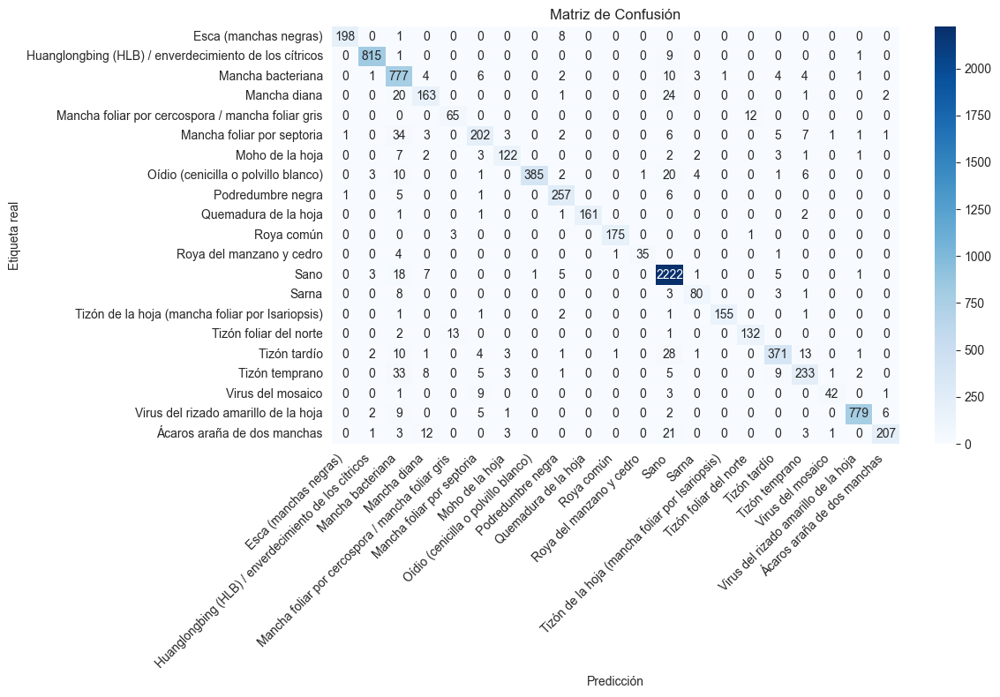

In [15]:
# cm[i,j] = cantidad de veces que la clase i fue predicha como j
cm = confusion_matrix(all_labels, all_preds)

plt.figure(figsize=(12, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=list(label_map.values()),
            yticklabels=list(label_map.values()))
plt.xlabel('Predicción')
plt.ylabel('Etiqueta real')
plt.title('Matriz de Confusión')
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

Analicemos las características visuales de las clases más confundidas entre sí. Para eso, primero veamos cuáles son. Para eso, tomamos la matriz de confusión y calculamos el porcentaje de confusión entre cada par de clases.

In [16]:
# nombres de clases en orden
classes = list(label_map.values())

# Asegurar que es un array float para porcentajes
cm = cm.astype(float)

In [17]:
n_classes = len(classes)
pair_confusions = []

for i in range(n_classes):
    for j in range(i+1, n_classes):  # evitar duplicar pares y diagonal
        conf_ij = cm[i, j]
        conf_ji = cm[j, i]

        total_pair = cm[i, :].sum() + cm[j, :].sum()  # total casos reales i + j

        perc = (conf_ij + conf_ji) / total_pair * 100 if total_pair > 0 else 0

        pair_confusions.append({
            'Clase 1': classes[i],
            'Clase 2': classes[j],
            'Conf_1→2': conf_ij,
            'Conf_2→1': conf_ji,
            '% Confusión mutua': perc
        })

df_pairs = pd.DataFrame(pair_confusions).sort_values('% Confusión mutua', ascending=False)

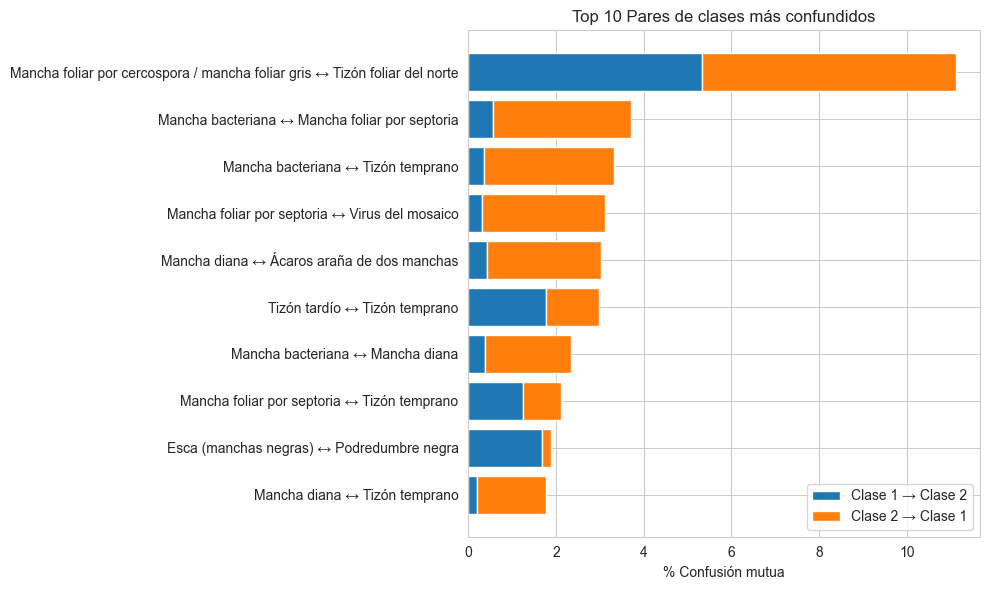

In [18]:
# Normalizar cada dirección respecto al total del par (no respecto al dataset completo)
df_pairs['% Conf_1→2'] = df_pairs['Conf_1→2'] / (df_pairs['Conf_1→2'] + df_pairs['Conf_2→1']) * df_pairs['% Confusión mutua']
df_pairs['% Conf_2→1'] = df_pairs['Conf_2→1'] / (df_pairs['Conf_1→2'] + df_pairs['Conf_2→1']) * df_pairs['% Confusión mutua']

top_n = 10
df_top = df_pairs.head(top_n)

y_labels = [f"{row['Clase 1']} ↔ {row['Clase 2']}" for _, row in df_top.iterrows()]
y_pos = np.arange(len(y_labels))

plt.figure(figsize=(10, 6))

plt.barh(
    y_pos,
    df_top['% Conf_1→2'],
    color='tab:blue',
    label='Clase 1 → Clase 2'
)
plt.barh(
    y_pos,
    df_top['% Conf_2→1'],
    left=df_top['% Conf_1→2'],
    color='tab:orange',
    label='Clase 2 → Clase 1'
)

plt.yticks(y_pos, y_labels)
plt.xlabel('% Confusión mutua')
plt.title(f'Top {top_n} Pares de clases más confundidos')
plt.legend()
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()

Y veamos a su vez el top, pero en total de casos de confusión, sin normalizar por el total del par.

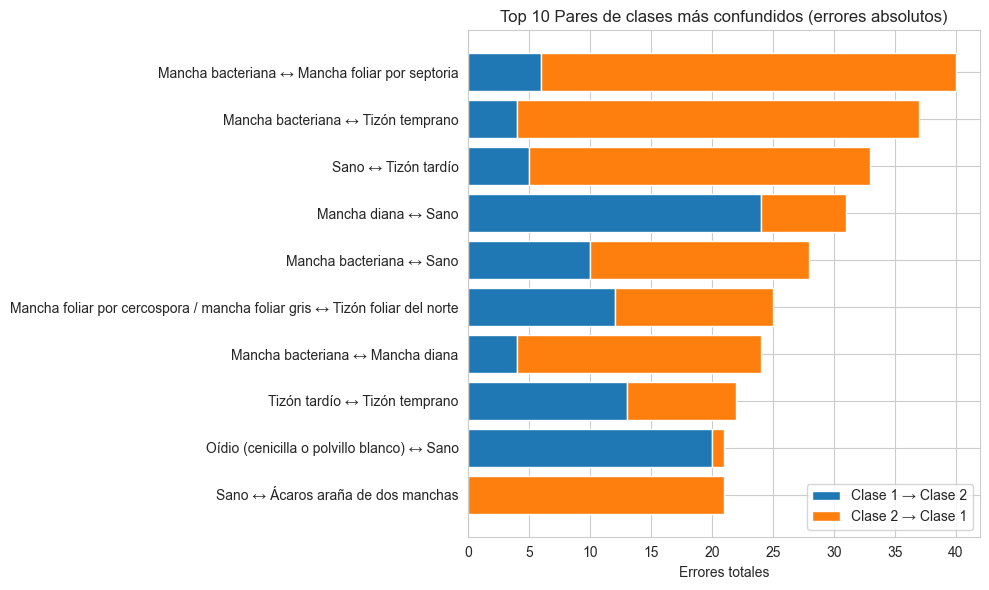

In [19]:
# Calcular confusión mutua en errores absolutos
pair_confusions_abs = []
for i in range(n_classes):
    for j in range(i+1, n_classes):  # evitar duplicar pares y diagonal
        conf_ij = cm[i, j]  # Clase i real → j predicha
        conf_ji = cm[j, i]  # Clase j real → i predicha
        total_errors = conf_ij + conf_ji
        if total_errors > 0:  # solo pares con algún error
            pair_confusions_abs.append({
                'Clase 1': classes[i],
                'Clase 2': classes[j],
                'Errores_1→2': conf_ij,
                'Errores_2→1': conf_ji,
                'Errores totales': total_errors
            })

df_pairs_abs = pd.DataFrame(pair_confusions_abs).sort_values('Errores totales', ascending=False)

df_top_abs = df_pairs_abs.head(top_n)

# Gráfico stacked bar horizontal
y_labels = [f"{row['Clase 1']} ↔ {row['Clase 2']}" for _, row in df_top_abs.iterrows()]
y_pos = np.arange(len(y_labels))

plt.figure(figsize=(10, 6))
plt.barh(
    y_pos,
    df_top_abs['Errores_1→2'],
    color='tab:blue',
    label='Clase 1 → Clase 2'
)
plt.barh(
    y_pos,
    df_top_abs['Errores_2→1'],
    left=df_top_abs['Errores_1→2'],
    color='tab:orange',
    label='Clase 2 → Clase 1'
)

plt.yticks(y_pos, y_labels)
plt.xlabel('Errores totales')
plt.title(f'Top {top_n} Pares de clases más confundidos (errores absolutos)')
plt.legend()
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()

Recapitulando los resultados, podemos profundizar un poco en las conclusiones:

1. Clases con peor desempeño relativo:

Aunque el accuracy general es alto (93%), hay clases con recall y precisión más bajos que están contribuyendo a la mayoría de los errores:

- Virus del mosaico (recall 0.750, precisión 0.933, 25% de error).
- Mancha foliar por septoria (recall 0.759, 24% de error).
- Mancha diana (recall 0.773, 22.7% de error).
- Tizón temprano (recall 0.777, 22.3% de error).
- Ácaros araña de dos manchas (recall 0.825, 17.5% de error).
- Sarna, Tizón tardío, Moho de la hoja (entre 14% y 16% de error).

Estas clases son candidatas para:
- Aumentar datos de entrenamiento (especialmente casos variados en iluminación, ángulo, etapa de la enfermedad).
- Aumentar la diferenciación visual (ej. data augmentation orientado a destacar texturas y colores distintivos).
- Revisar si la taxonomía o etiquetas tienen solapamiento visual fuerte con otras clases.

2. Confusiones más frecuentes entre clases distintas
De los gráficos presentados, se ven que hay pares dominantes:

- Mancha foliar gris ↔ Tizón foliar del norte: más de 10% de confusión mutua.
- Mancha foliar por septoria → Mancha bacteriana (34 casos).
- Tizón temprano → Mancha bacteriana (33 casos).
- Tizón tardío → Sano (28 casos).
- Mancha diana → Sano (24 casos).
- Ácaros araña de dos manchas → Sano (21 casos).
- Oídio → Sano (20 casos).

Además, dentro de la clase con recall más baja (Virus del mosaico), se confunde con Mancha foliar por septoria en la mayoría de los casos (9 de los 14 falsos negativos).

Esto indica que:

- Hay clases de síntomas leves o incipientes que el modelo confunde con Sano (por ejemplo, Mancha diana, Ácaros, Oídio, Tizón tardío). Además, el hecho de tener como clase mayoritaria "Sano" puede estar sesgando al modelo a predecir sano en casos dudosos.
- Algunas enfermedades foliares (Septoria, Mancha bacteriana, Tizón temprano) tienen patrones visuales muy parecidos, el modelo necesita features más discriminantes (quizá extracción de texturas, filtros de color).

Vamos a ver ejemplos de las clases más confundidas entre sí, para entender mejor qué características visuales tienen en común y por qué el modelo puede estar cometiendo errores:

In [21]:
# Valores de normalización de ImageNet
imagenet_mean = np.array([0.485, 0.456, 0.406])
imagenet_std = np.array([0.229, 0.224, 0.225])

def mostrar_ejemplos_par(clase1_idx, clase2_idx, clase1_name, clase2_name, n_ejemplos=4):
    """
    Muestra grilla 4xN de imágenes para los 4 escenarios entre dos clases:
    - Real: clase1 / Pred: clase1
    - Real: clase1 / Pred: clase2
    - Real: clase2 / Pred: clase1
    - Real: clase2 / Pred: clase2
    """
    escenarios = [
        (clase1_idx, clase1_idx, f"Real: {clase1_name}\nPred: {clase1_name}"),
        (clase1_idx, clase2_idx, f"Real: {clase1_name}\nPred: {clase2_name}"),
        (clase2_idx, clase1_idx, f"Real: {clase2_name}\nPred: {clase1_name}"),
        (clase2_idx, clase2_idx, f"Real: {clase2_name}\nPred: {clase2_name}")
    ]

    fig, axes = plt.subplots(4, n_ejemplos, figsize=(n_ejemplos*3, 4*3))

    for row_idx, (real_label, pred_label, title) in enumerate(escenarios):
        # Filtrar índices con ese escenario
        indices = [
            i for i, (y_true, y_pred) in enumerate(zip(all_labels, all_preds))
            if y_true == real_label and y_pred == pred_label
        ]

        # Elegir ejemplos aleatorios
        if len(indices) > n_ejemplos:
            indices = random.sample(indices, n_ejemplos)

        for col_idx in range(n_ejemplos):
            ax = axes[row_idx, col_idx]
            ax.axis('off')
            if col_idx < len(indices):
                img, _ = valid_dataset[indices[col_idx]]
                if torch.is_tensor(img):
                    img = img.permute(1, 2, 0).cpu().numpy()
                img = img * imagenet_std + imagenet_mean  # desnormalizar
                img = np.clip(img, 0, 1)
                ax.imshow(img)
            if col_idx == 0:
                ax.set_ylabel(title, fontsize=10)

    plt.tight_layout()
    plt.show()

Mostrando ejemplos para: Mancha foliar por cercospora / mancha foliar gris ↔ Tizón foliar del norte


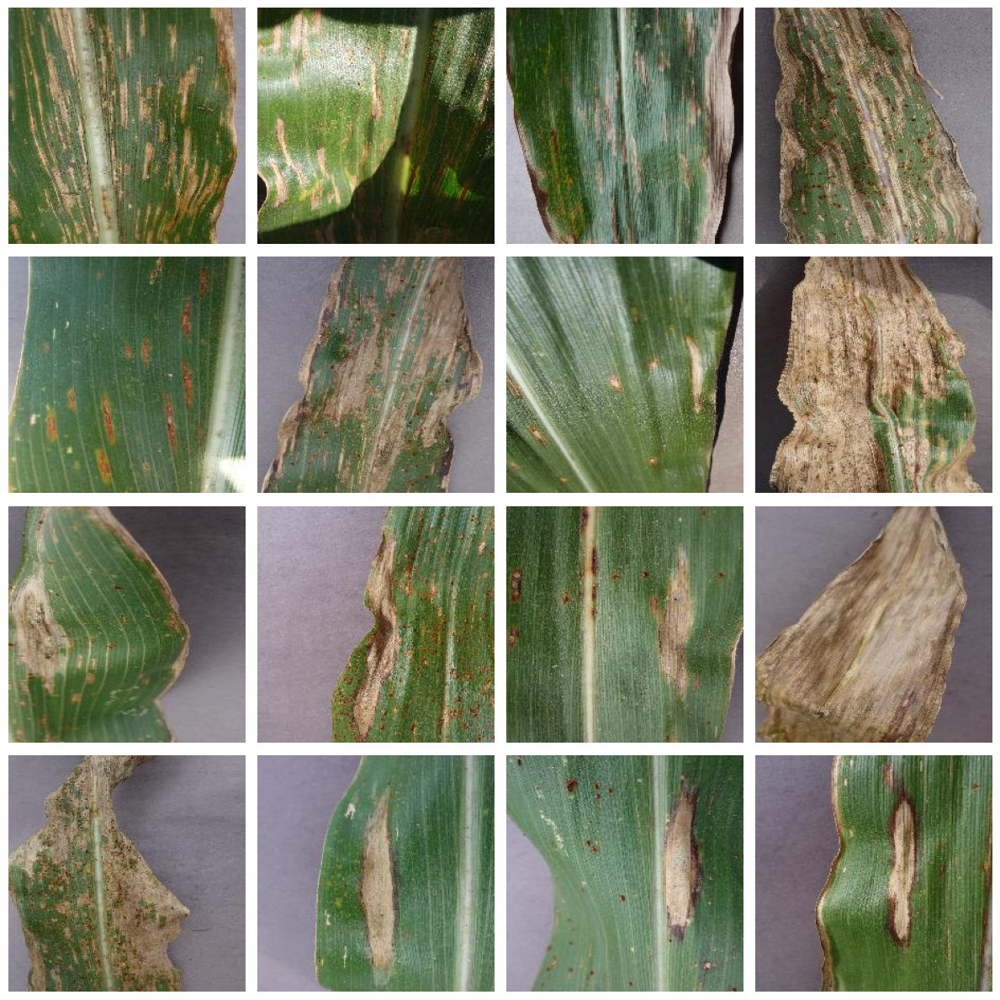

Mostrando ejemplos para: Mancha foliar por septoria ↔ Mancha bacteriana


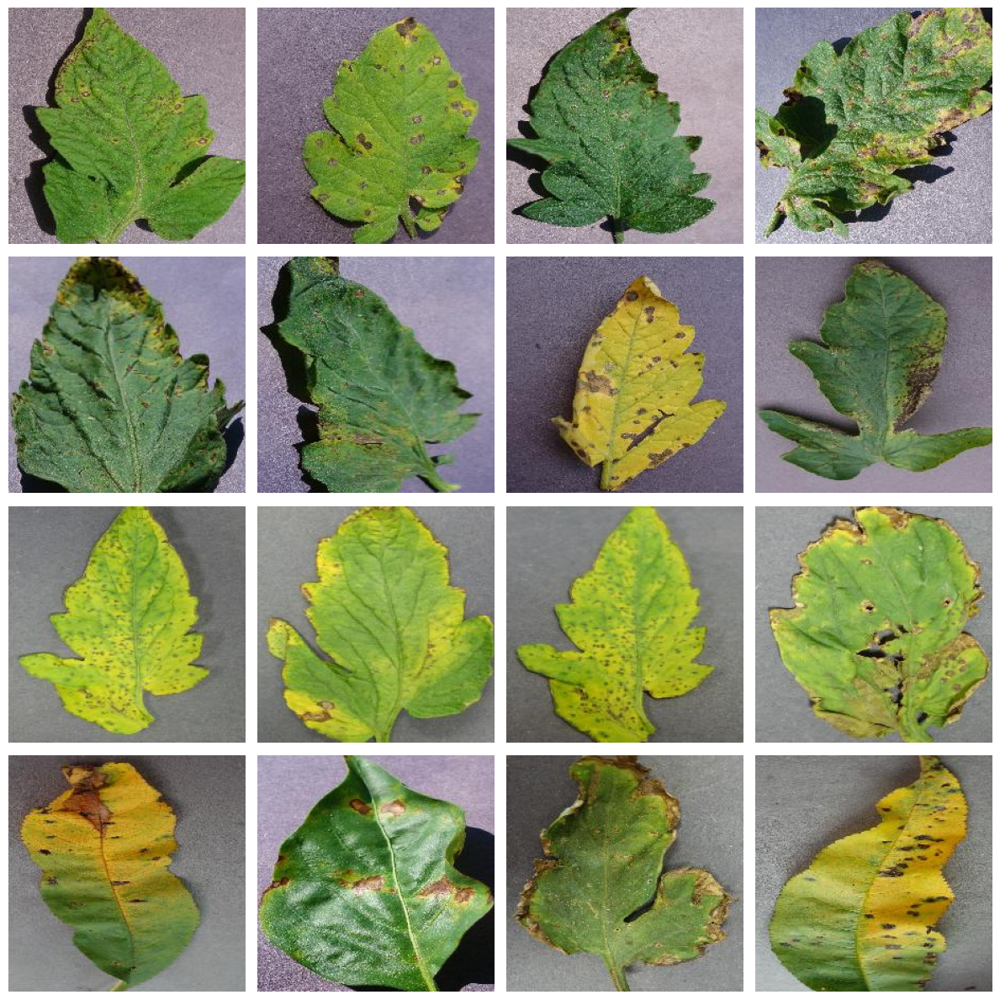

Mostrando ejemplos para: Tizón temprano ↔ Mancha bacteriana


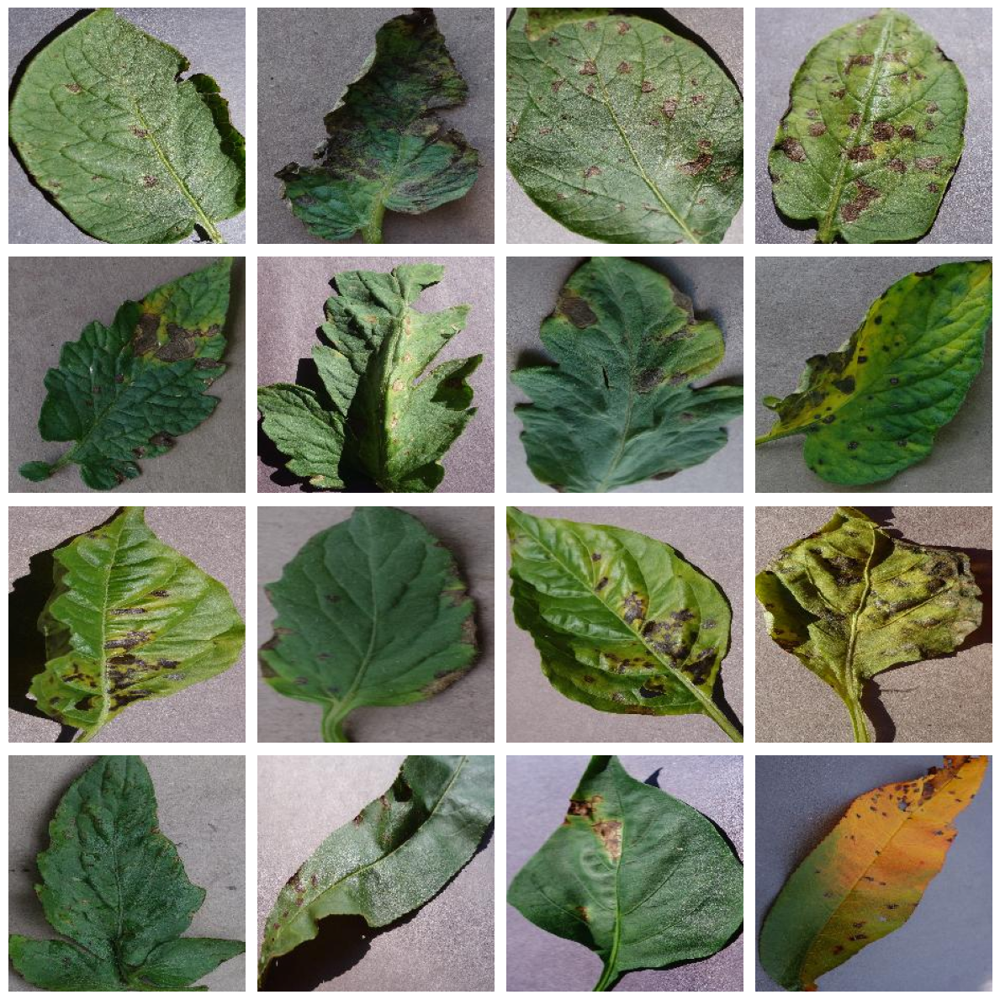

Mostrando ejemplos para: Tizón tardío ↔ Sano


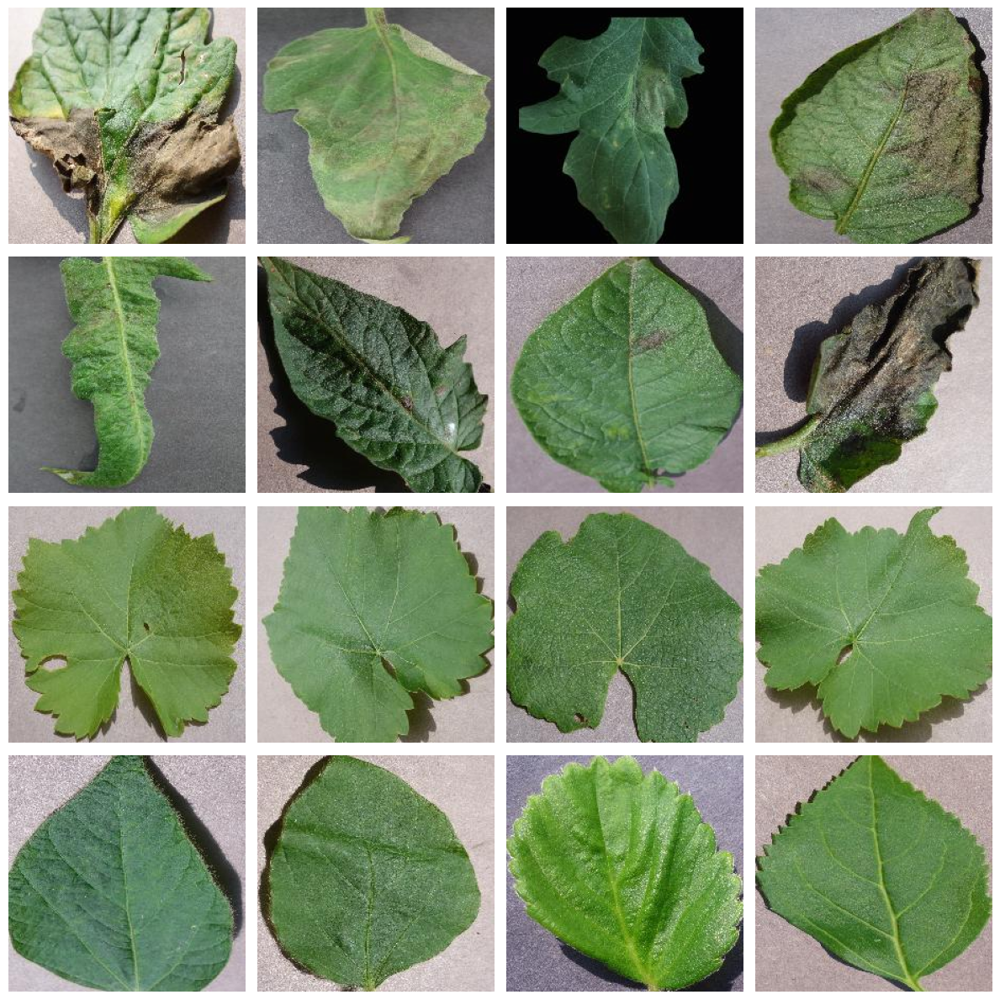

Mostrando ejemplos para: Mancha diana ↔ Sano


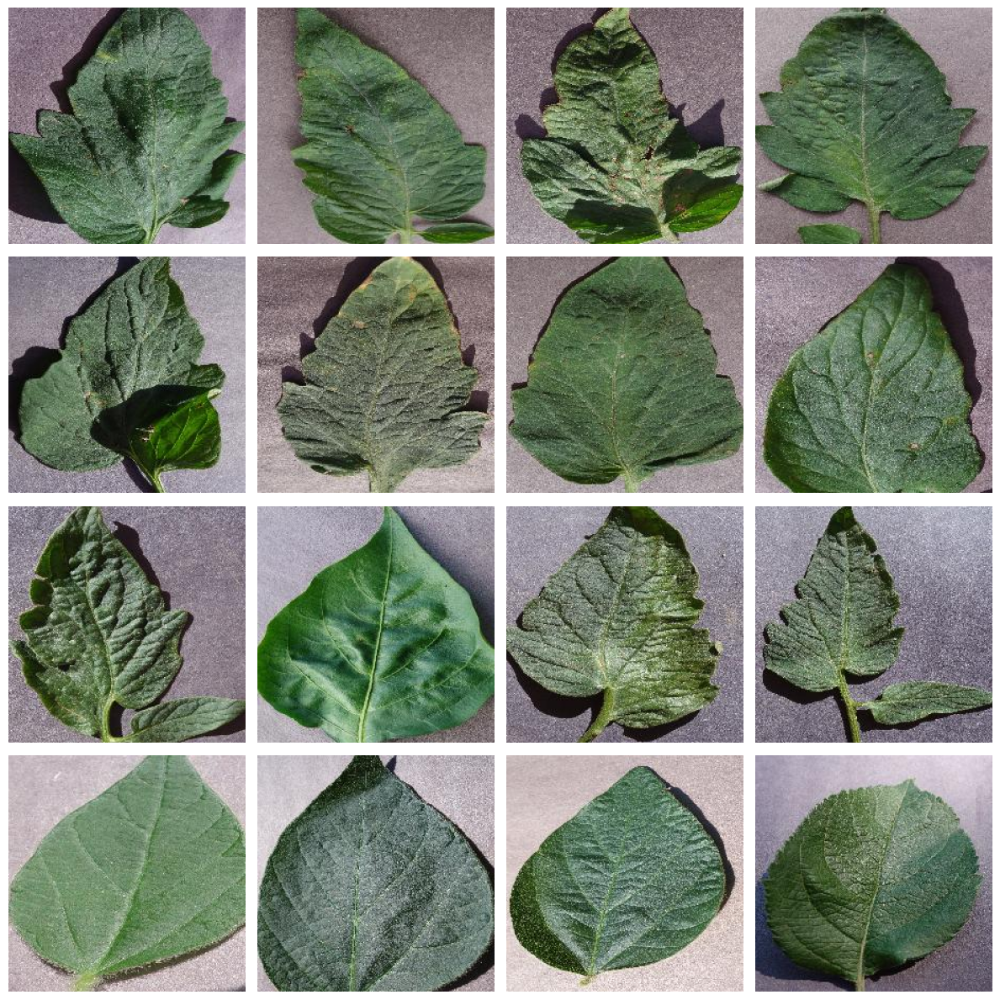

Mostrando ejemplos para: Ácaros araña de dos manchas ↔ Sano


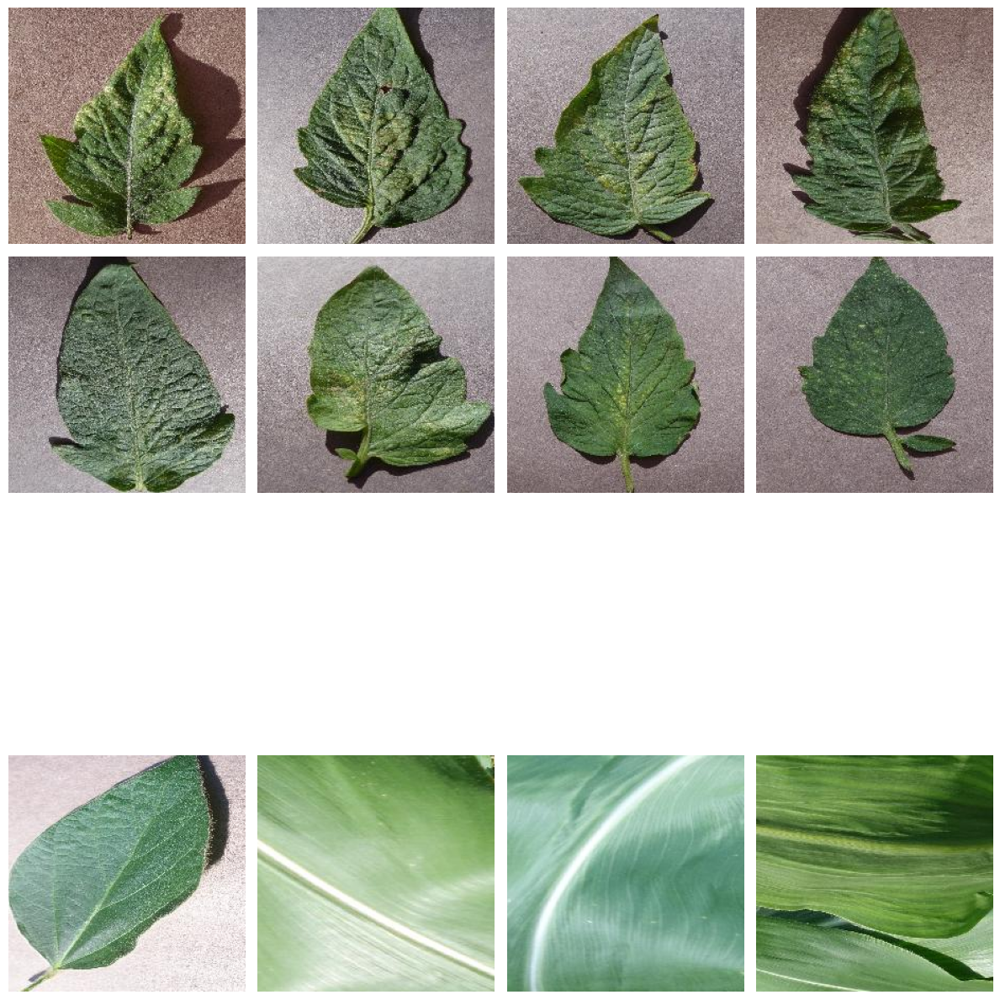

Mostrando ejemplos para: Oídio (cenicilla o polvillo blanco) ↔ Sano


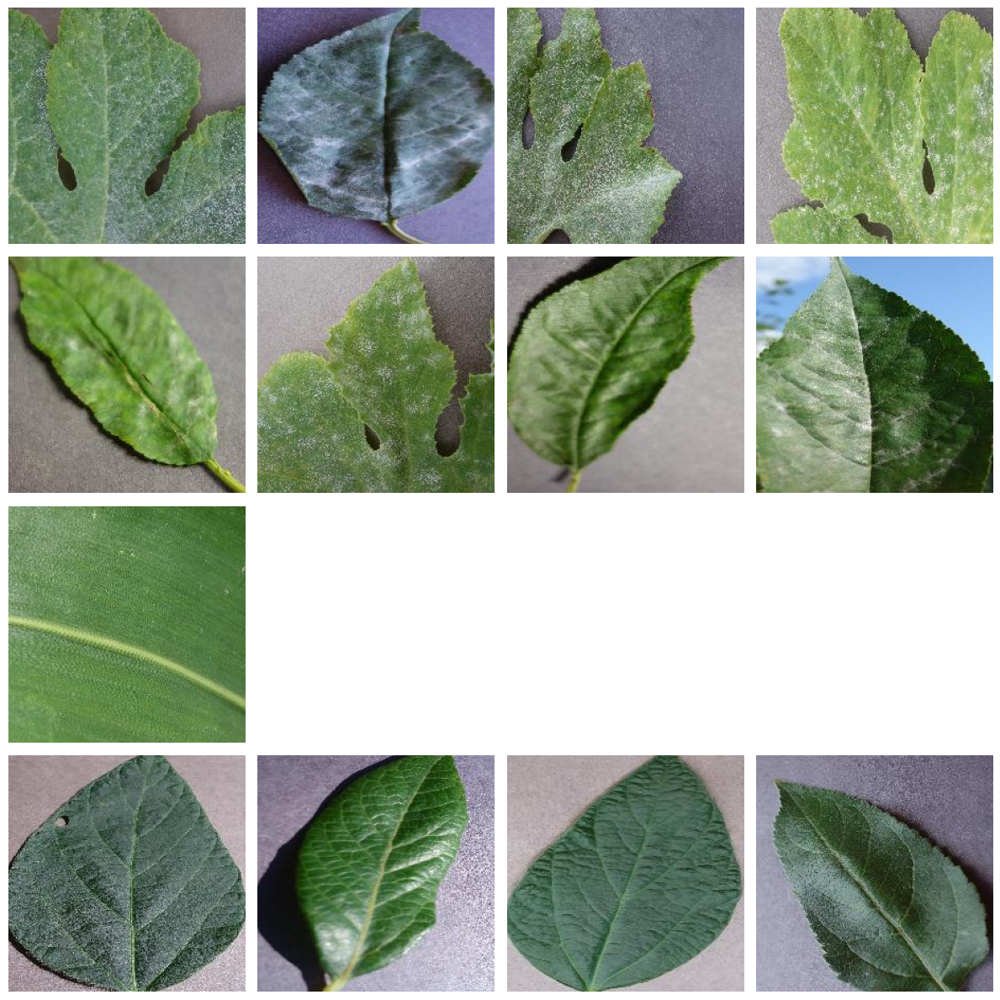

Mostrando ejemplos para: Virus del mosaico ↔ Mancha foliar por septoria


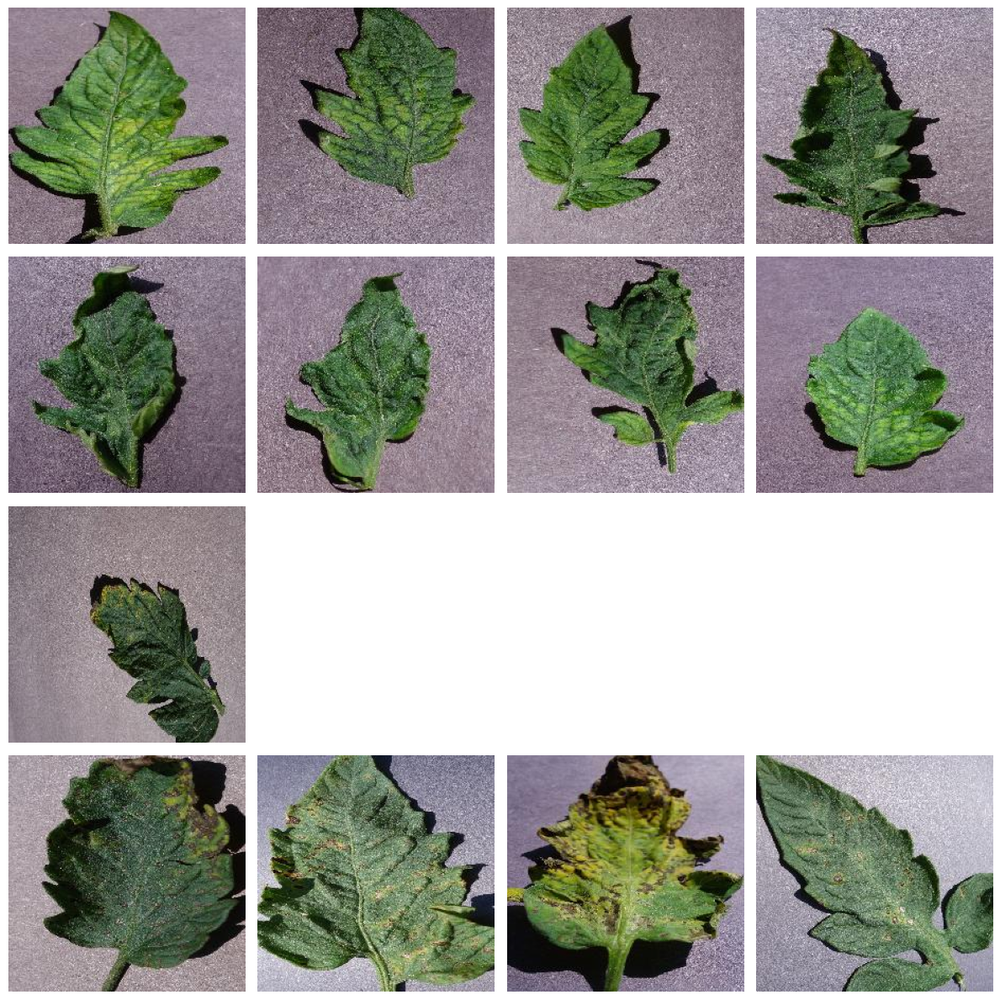

In [24]:
pares_interes = [
    ("Mancha foliar por cercospora / mancha foliar gris", "Tizón foliar del norte"),
    ("Mancha foliar por septoria", "Mancha bacteriana"),
    ("Tizón temprano", "Mancha bacteriana"),
    ("Tizón tardío", "Sano"),
    ("Mancha diana", "Sano"),
    ("Ácaros araña de dos manchas", "Sano"),
    ("Oídio (cenicilla o polvillo blanco)", "Sano"),
    ("Virus del mosaico", "Mancha foliar por septoria")
]

for clase1_name, clase2_name in pares_interes:
    c1 = classes.index(clase1_name)
    c2 = classes.index(clase2_name)
    print(f"Mostrando ejemplos para: {clase1_name} ↔ {clase2_name}")
    mostrar_ejemplos_par(c1, c2, clase1_name, clase2_name, n_ejemplos=4)

En algunos casos, las confusiones parecen razonables dada la similitud visual entre las enfermedades. Por ejemplo:
- Mancha foliar gris y Tizón foliar del norte tienen patrones de manchas similares, casi imperceptibles al ojo humano.
- Mancha foliar por septoria y mancha bacteriana, por el amarilleado de las hojas en algunos casos, y la presencia de manchas oscuras en todos los casos de ambos casos.

A su vez, muchas de las confusiones con la clase "Sano" parecen deberse a que los síntomas son leves o incipientes, y el modelo no logra distinguirlos claramente del follaje sano. Esto se observa en algunos casos de mancha diana y ácaros araña de dos manchas.